# Downsample block tests

This notebook is for test different internal structures for a downsample layer in an U-net. The goal is to adjust the network input (the single embedding vector of an embedding layer) and the network weights to match the output of the network to a target feature map.

In [1]:
import tensorflow as tf
import os
import logging
logging.getLogger("tensorflow").setLevel(logging.ERROR)
tf.autograph.set_verbosity(0)
import time
from matplotlib import pyplot as plt
from matplotlib.image import imread
from IPython import display
import numpy as np
from PIL import Image, ImageDraw
import glob
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())
#tf.compat.v1.disable_eager_execution()

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 12316861739006644417
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 4986830848
locality {
  bus_id: 1
  links {
  }
}
incarnation: 6392130262169707239
physical_device_desc: "device: 0, name: NVIDIA GeForce GTX 1660 Ti, pci bus id: 0000:01:00.0, compute capability: 7.5"
]


## Enable saving to Google Drive if working with colab, to external SSD, or disable if saving locally

In [2]:
def save_to(save = "locally"):
  if save == "colab":
    from google.colab import drive
    drive.mount('/content/drive')
    %cd drive/MyDrive/Colab Notebooks/drones
  elif save == "ssd":
    os.chdir("D:/GanNoMask")

save_to("ssd")

## Constants
Batch size is 1 for these tests, because the goal is to match the network output to a single feature map. Image width and height must be sufficiently large to provide a good statistical sample over the spatial plane. The convolutions will somewhat reduce the network output spatial size due to 'valid' padding. The network is hard-coded to have 1 input channel and 2 output channels.

In [3]:
BATCH_SIZE = 1
IMG_WIDTH = 512
IMG_HEIGHT = 512

## Isotropic low-pass anti-aliasing filter
To ensure that the network operation is not affected by the image axis orientations, and that the network operation is unaffected by sub-pixel shifts, an isotropic anti-aliasing filter is used with horizontal and vertical frequency domain overhead defined by an oversampling factor.

See: https://dsp.stackexchange.com/questions/58301/2-d-circularly-symmetric-low-pass-filter for the filter kernel calculation and https://dsp.stackexchange.com/questions/58226/auto-detection-of-rotation-angle-on-arbitrary-image-with-orthogonal-features/58287#58287 for the window function calculation.


In [4]:
oversampling = 2  # Oversampling factor, 2 is a good choice
kernelN = 9  # Horizontal size of the kernel, also its vertical size. Must be odd. 9 is a good choice when oversampling == 2.

from scipy import special

def circularLowpassKernel(omega_c, N):  # omega = cutoff frequency in radians (pi is max), N = horizontal size of the kernel, also its vertical size, must be odd.
  kernel = np.fromfunction(lambda x, y: omega_c*special.j1(omega_c*np.sqrt((x - (N - 1)/2)**2 + (y - (N - 1)/2)**2))/(2*np.pi*np.sqrt((x - (N - 1)/2)**2 + (y - (N - 1)/2)**2)), [N, N])
  kernel[(N - 1)//2, (N - 1)//2] = omega_c**2/(4*np.pi)
  return kernel 

def rotatedCosineWindow(N):  # N = horizontal size of the targeted kernel, also its vertical size, must be odd.
  return np.fromfunction(lambda y, x: np.maximum(np.cos(np.pi/2*np.sqrt(((x - (N - 1)/2)/((N - 1)/2 + 1))**2 + ((y - (N - 1)/2)/((N - 1)/2 + 1))**2)), 0), [N, N])

window = rotatedCosineWindow(kernelN)

kernel_cutoff_pi = circularLowpassKernel(np.pi/oversampling, kernelN)
windowedkernel_cutoff_pi = kernel_cutoff_pi*window
windowedkernel_cutoff_pi /= np.sum(windowedkernel_cutoff_pi, axis=(0, 1)) # Normalize to sum = 1
windowedkernel_cutoff_pi = windowedkernel_cutoff_pi.astype(np.float32)

#Divide by zero warnings are OK

C:\ProgramData\Miniconda3\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in true_divide
  import sys


Plot the anti-aliasing filter kernel and frequency response:

Kernel:


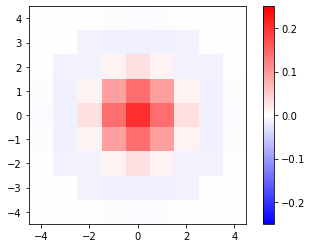

Frequency response:


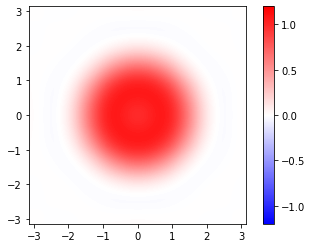

In [5]:
print("Kernel:")
plt.imshow(windowedkernel_cutoff_pi, vmin=-0.25, vmax=0.25, cmap='bwr', extent=[-kernelN/2, kernelN/2, -kernelN/2, kernelN/2])
plt.colorbar()
plt.show()

print("Frequency response:")
freq_resp = np.real(np.fft.fftshift(np.fft.fft2(np.roll(np.pad(windowedkernel_cutoff_pi, 100, mode = 'constant', constant_values = 0), shift = (-kernelN//2-99, -kernelN//2-99), axis = (0, 1)))))
plt.imshow(freq_resp, vmin=-1.2, vmax=1.2, cmap='bwr', extent=[-np.pi, np.pi, -np.pi, np.pi])
plt.colorbar()
plt.show()

#plt.plot(freq_resp[100])

# Network definition and network and target noise initialization

Initialize the network input, the network structure, the network, and target noise which is white noise with frequency-domain overhead as dictated by the oversampling factor (defined earlier):

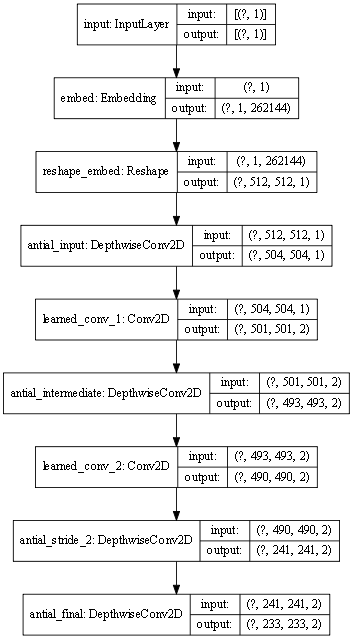

In [6]:
# Network input is just a single constant zero intended as input to the embedding layer
z = tf.constant(0, shape=(BATCH_SIZE, 1))

# Initialize an anti-aliasing layer
def init_antial(layer, kernel):
  reps = np.shape(layer.get_weights())[3]
  new_w = tf.repeat(tf.constant([[kernel]]), reps, axis = 3)
  new_w = tf.reshape(new_w, [kernel.shape[0], kernel.shape[1], reps, 1])
  layer.set_weights([new_w])
  layer.trainable = False

def Model():  
  z = tf.keras.Input(shape = (1, ), name = "input")

  x = z

  x = tf.keras.layers.Embedding(1, IMG_HEIGHT * IMG_WIDTH, input_length = 1, input_shape = (1, ), embeddings_initializer=tf.keras.initializers.RandomUniform(minval=-1, maxval=1, seed=None), name = "embed")(x)

  x = tf.keras.layers.Reshape((IMG_HEIGHT, IMG_WIDTH, 1), name = 'reshape_embed')(x)

  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_input")(x)

  # -------- downsample start ---------

  x = tf.keras.layers.Conv2D(2, 4, strides=1, padding='valid', activation=tf.keras.activations.relu, kernel_initializer=tf.keras.initializers.RandomUniform(-1, 1), use_bias=True, name = "learned_conv_1")(x)

  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_intermediate")(x)

  x = tf.keras.layers.Conv2D(2, 4, strides=1, padding='valid', activation=tf.keras.activations.relu, kernel_initializer=tf.keras.initializers.RandomUniform(-1, 1), use_bias=True, name = "learned_conv_2")(x)
  # Note that ReLu limits the output to non-negative values, so the target needs to be non-negative with isotropic filtering applied

  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=2, padding='valid', use_bias=False, name = "antial_stride_2")(x) # First, stride 2 anti-aliasing filter

  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_final")(x) # Then, restore frequency-domain overhead

  # -------- downsample ends ---------
  # -------- upsample starts ---------

  # 1. zero stuffing
  # 2. anti-aliasing (change cutoff here to a bit lower here!)
  # 3. conv2d learned 1, relu
  # 4. anti-aliasing
  # 5. conv2d learned 2, relu
  # 6. anti-aliasing

  # ---------- upsample ends ----------

  
  model = tf.keras.Model(inputs=z, outputs=x)

  init_antial(model.get_layer('antial_input'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_intermediate'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_stride_2'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_final'), windowedkernel_cutoff_pi)

  return model

model = Model()

def random_noise(batch_size, img_width, img_height, channels):
    noise_vector = tf.random.uniform([batch_size, img_width, img_height, channels]) # Uniform between 0 and 1
    return noise_vector

def filter_noise(noise, kernel):
  reps = tf.shape(noise)[-1]
  channeled_kernel = tf.repeat(kernel, reps)
  noise = tf.nn.depthwise_conv2d(noise, tf.reshape(channeled_kernel, (kernel.shape[0], kernel.shape[1], reps, 1)), [1, 1, 1, 1], padding = "VALID")
  return noise

noise = random_noise(BATCH_SIZE, model.output_shape[1] + kernelN - 1, model.output_shape[2] + kernelN - 1, 2)
target = filter_noise(noise, windowedkernel_cutoff_pi)

tf.keras.utils.plot_model(model, show_shapes=True, dpi=64)

## Define loss and optimizer

L2 loss is used. Adam optimizer is used.

In [7]:
def model_loss(gen_output, target):

  l2_loss = tf.reduce_mean((target - gen_output)**2)

  return l2_loss

def select_optimizer():
  #optimizer = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1=0.5, beta_2=0.99, epsilon=1e-07)
  optimizer = tf.keras.optimizers.Adam()
  return optimizer

optimizer = select_optimizer()

## Image saving, training step, and fit function
Save losses to TensorBoard, show and save network output and show some basic stats every `save_every` epochs. Save trained network when fitting is finished, after `epochs` epochs.

In [8]:
save_every = 100 # How many epochs to skip between data display and saving

def generate_images(model, z, target, save = False, epoch = 0, training = False): # the training parameter is for batchnorm, in case it is used
  prediction = model(z, training=training)
  plt.figure(figsize=(10, 10))
  # red = channel 0, green = channel 1, blue = channel 0
  first = tf.stack([prediction[0, ..., 0], prediction[0, ..., 1], prediction[0, ..., 0]], axis = -1) 
  second = tf.stack([target[0, ..., 0], target[0, ..., 1], target[0, ..., 0]], axis = -1)
  display_list = [first, second]
  title = ['Network output', 'Target']
  
  if save:
    name = str(epoch).zfill(4)
    tf.keras.preprocessing.image.save_img((im_dir + str(name) + ".png"), first)

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    plt.imshow(display_list[i])
    plt.axis('off')
  plt.show()

@tf.function
def train_step(z, target, epoch):
  with tf.GradientTape() as tape:
    gen_output = model(z, training=True)
    loss = model_loss(gen_output, target)
    
  gradients = tape.gradient(loss, model.trainable_variables)
  
  optimizer.apply_gradients(zip(gradients, model.trainable_variables))
  
  with summary_writer.as_default():
    tf.summary.scalar('model_loss', loss, step=epoch)

def fit(epochs):
  for epoch in range(epochs + 1):
    
    # Train
    start = time.time()
    if epoch > 0:
      train_step(z, target, epoch)
    elapsed = time.time() - start
    if epoch % save_every == 0 or epoch == epochs:
      #display.clear_output(wait=True)      
      generate_images(model, z, target, save = True) #training = ?
      if epoch == 0:
        print("Before fitting")
      else:
        print('Training epoch {}, took {} s\n'.format(epoch, elapsed))
      print("Loss: " + str(tf.keras.backend.get_value(model_loss(model(z, training=True), target))))
      print("RMS deviance: " + str(tf.keras.backend.get_value(tf.math.sqrt(tf.reduce_mean((target - model(z, training=True))**2)))))
      print("Learned Min: " + str(tf.keras.backend.get_value(tf.math.reduce_min(model.get_layer('learned_conv_1').get_weights()[0]))))
      print("Learned RMS: " + str(tf.keras.backend.get_value(tf.math.sqrt(tf.math.reduce_mean(model.get_layer('learned_conv_1').get_weights()[0]**2)))))
      print("Learned Max: " + str(tf.keras.backend.get_value(tf.math.reduce_max(model.get_layer('learned_conv_1').get_weights()[0]))))
      print("Embedding RMS: " + str(tf.keras.backend.get_value(tf.math.sqrt(tf.math.reduce_mean(model.get_layer('embed').get_weights()[0]**2)))))
    
  checkpoint.save(file_prefix=checkpoint_prefix)

## Initiate image and log dirs and TensorBoard

In [10]:
checkpoint_dir = './training_checkpoints_downsample'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(model=model)
checkpoint.save(file_prefix=checkpoint_prefix)

def checkpoint_save(epoch, inEpochs = 30):
  if (epoch + 1) % inEpochs == 0:
    checkpoint.save(file_prefix=checkpoint_prefix)

import datetime
log_dir = "logs/"
im_dir = "images/fit" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + "/"
os.makedirs(im_dir)
summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [12]:
%reload_ext tensorboard
%tensorboard --logdir {log_dir} --host localhost --port 6125

Reusing TensorBoard on port 6125 (pid 16772), started 0:00:59 ago. (Use '!kill 16772' to kill it.)

## Fit the model

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


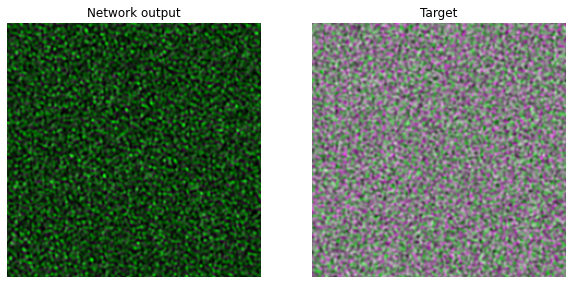

Before fitting
Loss: 0.14674392
RMS deviance: 0.3830717
Learned Min: -0.9142761
Learned RMS: 0.55645335
Learned Max: 0.87379503
Embedding RMS: 0.57730645


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


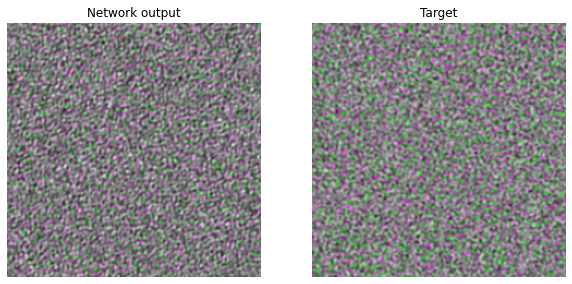

Training epoch 100, took 0.3074171543121338 s

Loss: 0.022101305
RMS deviance: 0.14866509
Learned Min: -0.98685277
Learned RMS: 0.5619989
Learned Max: 0.93415534
Embedding RMS: 0.5824102


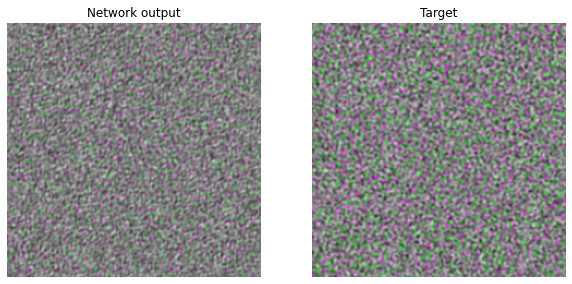

Training epoch 200, took 0.2566342353820801 s

Loss: 0.011314709
RMS deviance: 0.10637062
Learned Min: -0.9935491
Learned RMS: 0.5572605
Learned Max: 0.89485204
Embedding RMS: 0.58063155


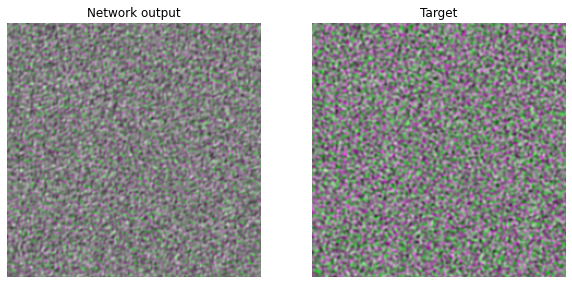

Training epoch 300, took 0.28045225143432617 s

Loss: 0.008030678
RMS deviance: 0.08961405
Learned Min: -0.9966376
Learned RMS: 0.555945
Learned Max: 0.8881817
Embedding RMS: 0.5802055


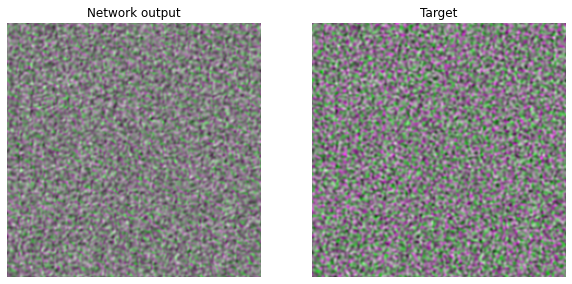

Training epoch 400, took 0.2701280117034912 s

Loss: 0.0063801836
RMS deviance: 0.07987605
Learned Min: -0.9986188
Learned RMS: 0.5563506
Learned Max: 0.8929197
Embedding RMS: 0.58037263


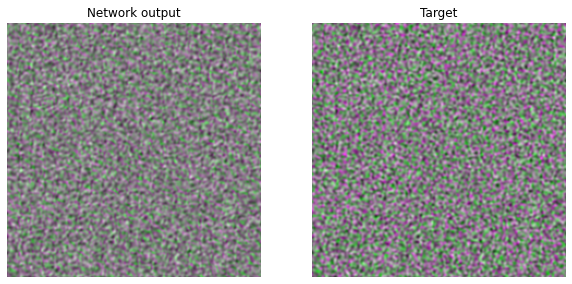

Training epoch 500, took 0.3920009136199951 s

Loss: 0.005249745
RMS deviance: 0.07245512
Learned Min: -1.0005869
Learned RMS: 0.55755067
Learned Max: 0.9080223
Embedding RMS: 0.5808242


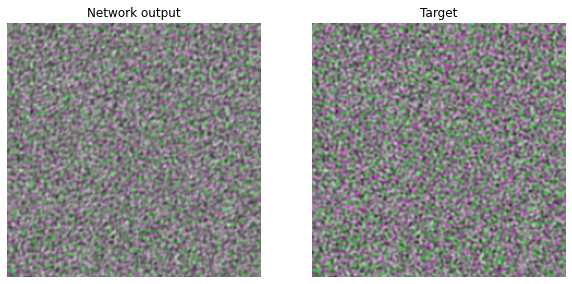

Training epoch 600, took 0.25600385665893555 s

Loss: 0.0043516844
RMS deviance: 0.0659673
Learned Min: -1.0028465
Learned RMS: 0.55904424
Learned Max: 0.9196522
Embedding RMS: 0.5814164


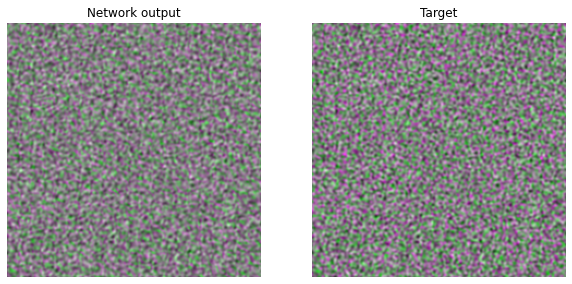

Training epoch 700, took 0.2669823169708252 s

Loss: 0.003616766
RMS deviance: 0.060139555
Learned Min: -1.0052865
Learned RMS: 0.5606115
Learned Max: 0.92926204
Embedding RMS: 0.5820652


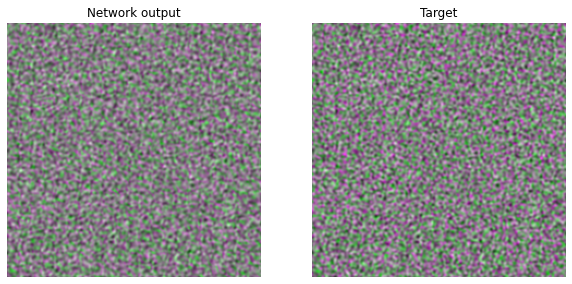

Training epoch 800, took 0.2606678009033203 s

Loss: 0.0030303844
RMS deviance: 0.055048928
Learned Min: -1.0076056
Learned RMS: 0.56208986
Learned Max: 0.93802625
Embedding RMS: 0.5827191


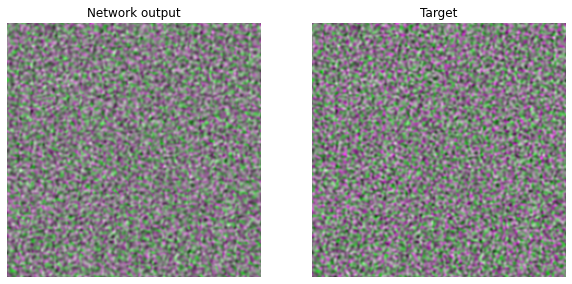

Training epoch 900, took 0.2989649772644043 s

Loss: 0.0025714661
RMS deviance: 0.050709628
Learned Min: -1.0096072
Learned RMS: 0.56348395
Learned Max: 0.94539684
Embedding RMS: 0.58335656


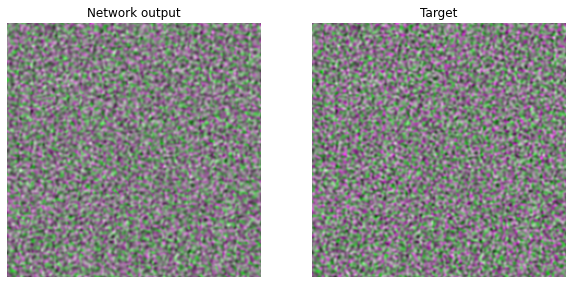

Training epoch 1000, took 0.28434300422668457 s

Loss: 0.0022164613
RMS deviance: 0.04707931
Learned Min: -1.0112466
Learned RMS: 0.5648084
Learned Max: 0.95184153
Embedding RMS: 0.583963


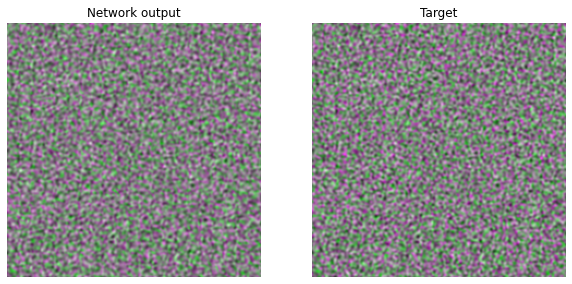

Training epoch 1100, took 0.25874829292297363 s

Loss: 0.0019407269
RMS deviance: 0.04405368
Learned Min: -1.0126238
Learned RMS: 0.5660771
Learned Max: 0.9585325
Embedding RMS: 0.58453643


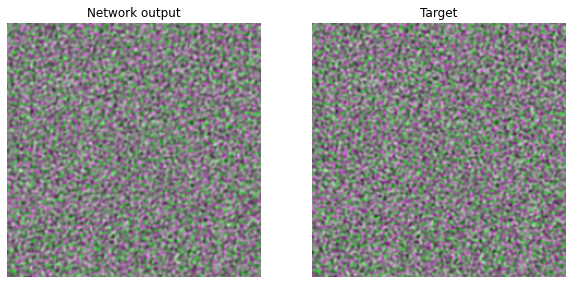

Training epoch 1200, took 0.2604851722717285 s

Loss: 0.0017205047
RMS deviance: 0.041478965
Learned Min: -1.0137789
Learned RMS: 0.5672628
Learned Max: 0.9653703
Embedding RMS: 0.5850687


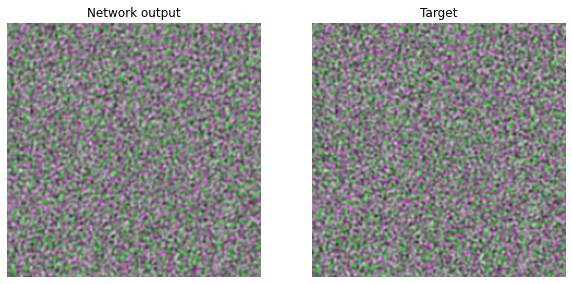

Training epoch 1300, took 0.26213622093200684 s

Loss: 0.0015399725
RMS deviance: 0.039242484
Learned Min: -1.014636
Learned RMS: 0.5684153
Learned Max: 0.9723257
Embedding RMS: 0.5855644


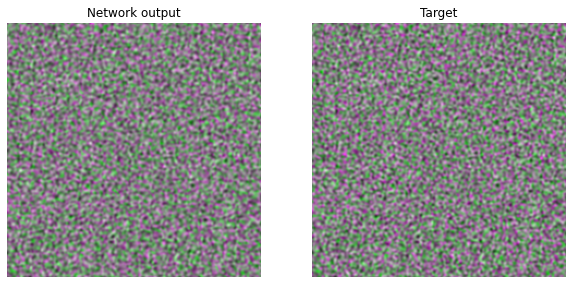

Training epoch 1400, took 0.2670729160308838 s

Loss: 0.001388458
RMS deviance: 0.03726202
Learned Min: -1.0153189
Learned RMS: 0.5695604
Learned Max: 0.97937256
Embedding RMS: 0.58603054


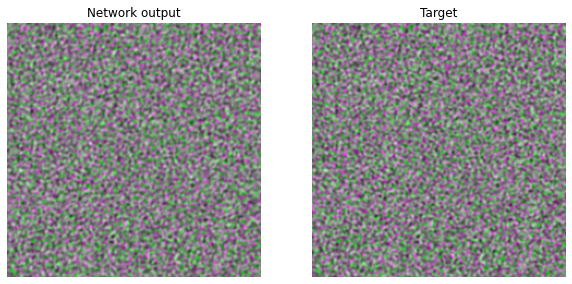

Training epoch 1500, took 0.3093080520629883 s

Loss: 0.0012616842
RMS deviance: 0.035520196
Learned Min: -1.015916
Learned RMS: 0.5706861
Learned Max: 0.98669344
Embedding RMS: 0.58647144


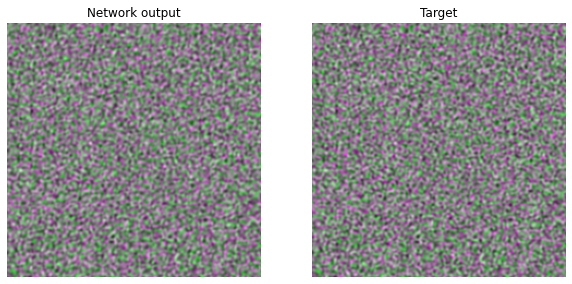

Training epoch 1600, took 0.26790547370910645 s

Loss: 0.0011533312
RMS deviance: 0.03396073
Learned Min: -1.0164446
Learned RMS: 0.57180256
Learned Max: 0.9944319
Embedding RMS: 0.58689225


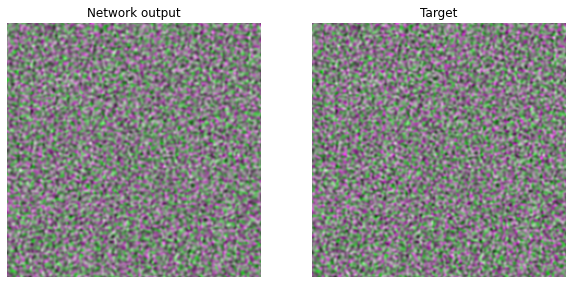

Training epoch 1700, took 0.3060154914855957 s

Loss: 0.0010596232
RMS deviance: 0.032551855
Learned Min: -1.0169221
Learned RMS: 0.5729206
Learned Max: 1.0020777
Embedding RMS: 0.5872964


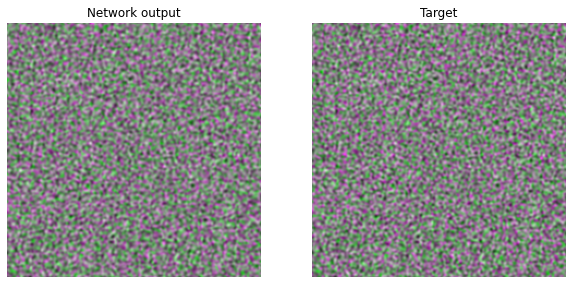

Training epoch 1800, took 0.29282331466674805 s

Loss: 0.0009781715
RMS deviance: 0.031275734
Learned Min: -1.0174228
Learned RMS: 0.5740624
Learned Max: 1.0100715
Embedding RMS: 0.5876912


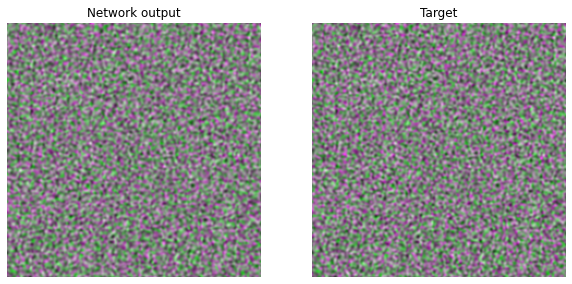

Training epoch 1900, took 0.2790234088897705 s

Loss: 0.0009067061
RMS deviance: 0.03011156
Learned Min: -1.0179232
Learned RMS: 0.5752095
Learned Max: 1.0181977
Embedding RMS: 0.58807313


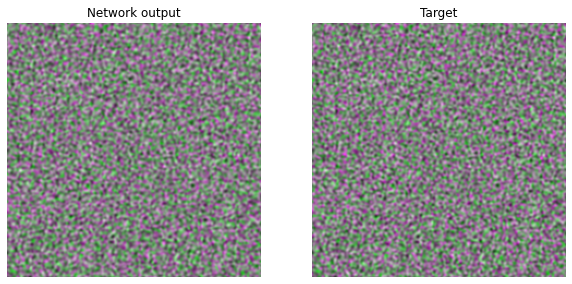

Training epoch 2000, took 0.2940206527709961 s

Loss: 0.00084337516
RMS deviance: 0.029040921
Learned Min: -1.0183927
Learned RMS: 0.5763507
Learned Max: 1.0263438
Embedding RMS: 0.58843905


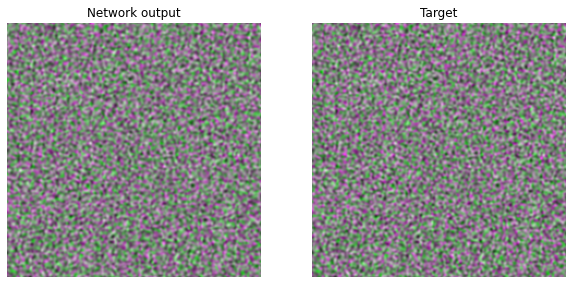

Training epoch 2100, took 0.28969836235046387 s

Loss: 0.00078666676
RMS deviance: 0.02804758
Learned Min: -1.0188538
Learned RMS: 0.5774964
Learned Max: 1.034566
Embedding RMS: 0.5887905


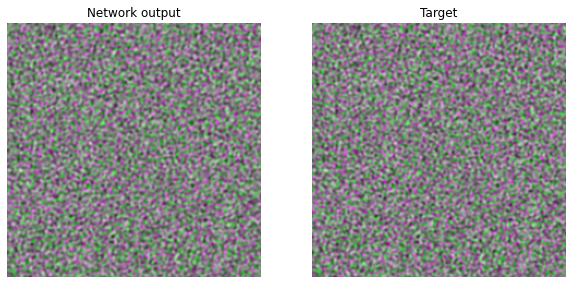

Training epoch 2200, took 0.29320549964904785 s

Loss: 0.0007357146
RMS deviance: 0.02712406
Learned Min: -1.0193139
Learned RMS: 0.57863945
Learned Max: 1.0429096
Embedding RMS: 0.5891272


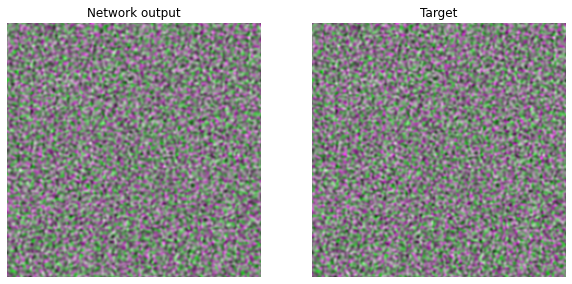

Training epoch 2300, took 0.28695082664489746 s

Loss: 0.00068959757
RMS deviance: 0.02626019
Learned Min: -1.0197686
Learned RMS: 0.57978666
Learned Max: 1.0512328
Embedding RMS: 0.5894526


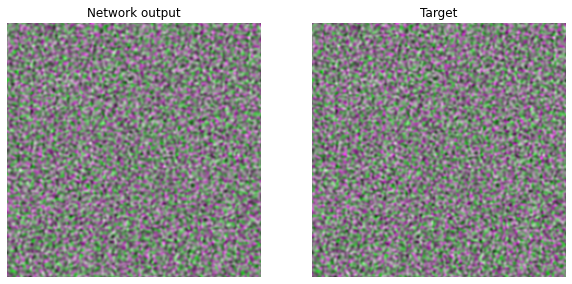

Training epoch 2400, took 0.28954124450683594 s

Loss: 0.0006479548
RMS deviance: 0.025454957
Learned Min: -1.0202638
Learned RMS: 0.5809522
Learned Max: 1.0595734
Embedding RMS: 0.5897688


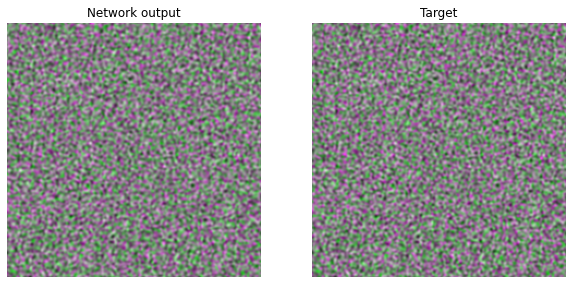

Training epoch 2500, took 0.3130006790161133 s

Loss: 0.00061011896
RMS deviance: 0.024700586
Learned Min: -1.0207635
Learned RMS: 0.58212626
Learned Max: 1.0678531
Embedding RMS: 0.59007555


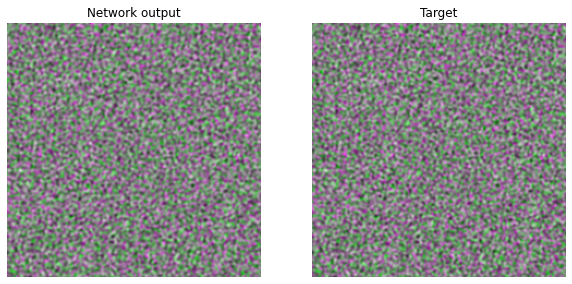

Training epoch 2600, took 0.34931135177612305 s

Loss: 0.00057567947
RMS deviance: 0.02399332
Learned Min: -1.0212644
Learned RMS: 0.5833182
Learned Max: 1.0762532
Embedding RMS: 0.5903717


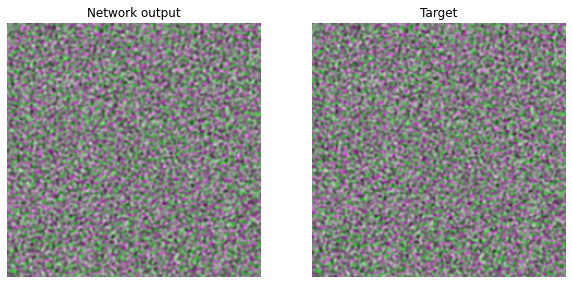

Training epoch 2700, took 0.2986795902252197 s

Loss: 0.0005441867
RMS deviance: 0.023327809
Learned Min: -1.0217658
Learned RMS: 0.58453137
Learned Max: 1.0845495
Embedding RMS: 0.5906581


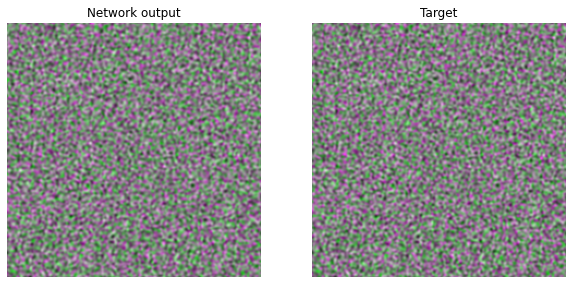

Training epoch 2800, took 0.33972620964050293 s

Loss: 0.0005150221
RMS deviance: 0.022694098
Learned Min: -1.022288
Learned RMS: 0.585762
Learned Max: 1.0928193
Embedding RMS: 0.5909375


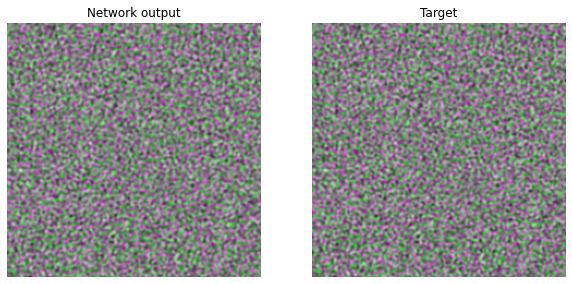

Training epoch 2900, took 0.325702428817749 s

Loss: 0.00048836716
RMS deviance: 0.022099031
Learned Min: -1.0228039
Learned RMS: 0.5869944
Learned Max: 1.100973
Embedding RMS: 0.59120786


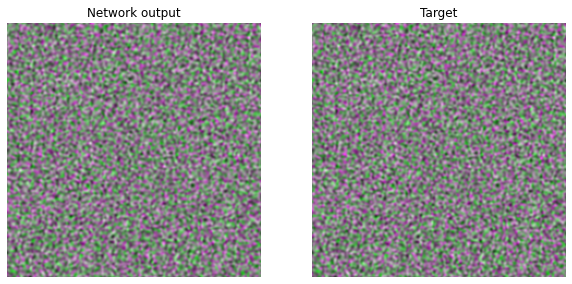

Training epoch 3000, took 0.31707310676574707 s

Loss: 0.00046382076
RMS deviance: 0.0215365
Learned Min: -1.0233442
Learned RMS: 0.5882593
Learned Max: 1.1091605
Embedding RMS: 0.59147346


In [13]:
EPOCHS = 3000
fit(EPOCHS)

In [14]:
print("learned_conv_1 weights and biases:\n")
print(model.get_layer('learned_conv_1').get_weights())
print("\nlearned_conv_2 weights and biases:\n")
print(model.get_layer('learned_conv_2').get_weights())

learned_conv_1 weights and biases:

[array([[[[-0.94973624, -0.9030416 ]],

        [[ 0.48296693,  0.40872353]],

        [[ 0.08086881, -0.4688723 ]],

        [[ 0.15249838,  0.22300981]]],


       [[[ 0.60749876,  0.1276281 ]],

        [[-0.3970263 , -0.59688437]],

        [[-0.54838204,  0.49983656]],

        [[ 0.49287933,  0.25426695]]],


       [[[ 0.13116203,  0.0097908 ]],

        [[ 1.1091605 , -0.78350705]],

        [[-0.80248576, -0.30360037]],

        [[-0.5613746 ,  0.35239384]]],


       [[[ 0.80437833,  0.79768115]],

        [[ 0.17592831,  0.09591913]],

        [[ 0.29907745, -1.0233442 ]],

        [[ 0.69078827,  0.96165335]]]], dtype=float32), array([-0.08318789,  0.07589049], dtype=float32)]

learned_conv_2 weights and biases:

[array([[[[ 0.24661964,  0.06856785],
         [-0.31802264, -0.9636979 ]],

        [[-0.18052517,  0.7896716 ],
         [-0.8330658 , -0.00529913]],

        [[ 1.0381749 , -0.6085476 ],
         [ 0.9913018 ,  0.72856635]],



In [12]:
def load_ckpt(latest = True, number = 1):
  if latest:
    checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
  else:
    checkpoint.restore('training_checkpoints_test/ckpt-' + str(number))

# load_ckpt(False, 46)